# Check how the output changes when each of the lora blocks is applied

In [1]:
import sys
import os 
sys.path.append(os.path.abspath(os.path.join("", "weights2weights")))
from copy import deepcopy
import matplotlib.pyplot as plt

import torch
device = "cuda:0"

from diffusers import DiffusionPipeline 
from peft import PeftModel
from peft.utils.save_and_load import load_peft_weights

from utils import load_models, unflatten

In [2]:
import torchvision.transforms as transforms
transform = transforms.ToTensor()

## 1. Get base model

In [3]:
import gc
del model
gc.collect()
torch.cuda.empty_cache()

NameError: name 'model' is not defined

In [4]:
# get model with index 7 from dataset of model weights
model = torch.load(f"weights2weights/weights_datasets/identities/all_weights.pt", torch.device(device))[11, :].unsqueeze(0)

In [5]:
# get weights dimensions
weight_dimensions = torch.load(f"weights2weights/weights_datasets/weight_dimensions.pt")

In [6]:
# change working directory to work with utils functions
model_path = os.path.join(os.getcwd(), "base_model_11")
%cd weights2weights/weights_datasets

/net/tscratch/people/plgkingak/.cache/models--snap-research--weights2weights/snapshots/3c5604a8d5d299df416d98d3ee196603b2e2706d/weights_datasets


In [7]:
# safe model compatible with Diffusers
unflatten(model, weight_dimensions, model_path)

In [8]:
pipe = DiffusionPipeline.from_pretrained("stablediffusionapi/realistic-vision-v51", 
                                         torch_dtype=torch.float16,safety_checker = None,
                                         requires_safety_checker = False).to(device)
   
pipe.unet = PeftModel.from_pretrained(pipe.unet, f"{model_path}/unet", adapter_name="identity1")
adapters_weights1 = load_peft_weights(f"{model_path}/unet", device="cuda:0")
pipe.unet.load_state_dict(adapters_weights1, strict = False)
pipe.to(device)

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

StableDiffusionPipeline {
  "_class_name": "StableDiffusionPipeline",
  "_diffusers_version": "0.28.0",
  "_name_or_path": "stablediffusionapi/realistic-vision-v51",
  "feature_extractor": [
    "transformers",
    "CLIPFeatureExtractor"
  ],
  "image_encoder": [
    null,
    null
  ],
  "requires_safety_checker": false,
  "safety_checker": [
    null,
    null
  ],
  "scheduler": [
    "diffusers",
    "PNDMScheduler"
  ],
  "text_encoder": [
    "transformers",
    "CLIPTextModel"
  ],
  "tokenizer": [
    "transformers",
    "CLIPTokenizer"
  ],
  "unet": [
    "diffusers",
    "UNet2DConditionModel"
  ],
  "vae": [
    "diffusers",
    "AutoencoderKL"
  ]
}

## 2. Generate output

  0%|          | 0/50 [00:00<?, ?it/s]

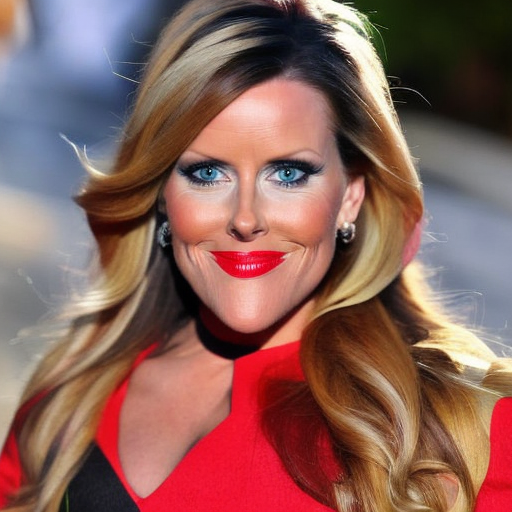

In [9]:
#random seed generator
generator = torch.Generator(device=device)
generator = generator.manual_seed(5)
latents = torch.randn(
        (1, pipe.unet.in_channels, 512 // 8, 512 // 8),
        generator = generator,
        device = device
    ).half()

#inference parameters
prompt = "sks person" #"sks person in a hat in a forest"
negative_prompt = "low quality, blurry, unfinished"
guidance_scale = 3
ddim_steps = 50
#run inference
image = pipe(prompt, num_inference_steps=ddim_steps, guidance_scale=guidance_scale,  negative_prompt=negative_prompt, latents = latents ).images[0]
image

In [10]:
i0 = transform(image)
img0 = i0.unsqueeze(0)

## 3. Add LoRA blocks one by one

In [11]:
from safetensors.torch import load_file

# Get weights dictionary
base_weights = load_file( f"{model_path}/unet/adapter_model.safetensors")

In [12]:
from torchmetrics.image.lpip import LearnedPerceptualImagePatchSimilarity as LPIPS

### 3.1 Editing one attention in a block

In [13]:
metrics = {}
lpips = LPIPS(net_type='vgg', normalize=True)
key_groups = set([".".join(i.split(".")[:6]) for i in list(base_weights.keys())])
key_groups = sorted(list(key_groups))
key_groups = [""] + key_groups + ["empty"]

for g in key_groups:
    new_weights = deepcopy(base_weights)
    for key in base_weights.keys():
        if g not in key:        
            new_weights[key] = torch.zeros_like(base_weights[key])
            
    flattened_weights = torch.cat([w.flatten() for w in new_weights.values()])
    pipe1 = DiffusionPipeline.from_pretrained("stablediffusionapi/realistic-vision-v51", 
                                        torch_dtype=torch.float16,safety_checker = None,
                                        requires_safety_checker = False).to(device)

    pipe1.unet = PeftModel.from_pretrained(pipe1.unet, f"{model_path}/unet", adapter_name="identity1")
    # adapters_weights1 = load_peft_weights(f"{model_path}/unet", device="cuda:0")
    pipe1.unet.load_state_dict(new_weights, strict = False)
    pipe1.to(device)
    image1 = pipe1(prompt, num_inference_steps=ddim_steps, guidance_scale=guidance_scale,  negative_prompt=negative_prompt, latents = latents ).images[0]
    i1 = transform(image1)
    mse = torch.mean((i0 - i1) ** 2)
    img1 = i1.unsqueeze(0)
    l = lpips(img0, img1)
    metrics[g] = (mse, l, image1, flattened_weights)

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

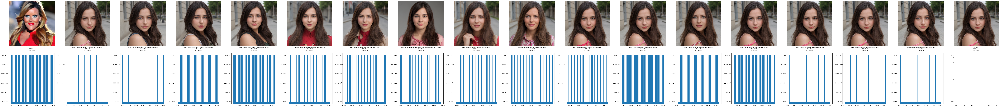

In [14]:
# Plot images side by side
fig, axes = plt.subplots(2, len(metrics), figsize=(len(metrics) * 6, 12))

for (ax_img, ax_hist), (k, v) in zip(zip(axes[0], axes[1]), metrics.items()):
    m, l, img, weights = v
    ax_img.imshow(img)
    ax_img.text(0.5, -0.1, f"{k}\nMSE:{round(m.item(),2)}\nLPIPS:{round(l.item(),2)}",fontsize=10, ha="center", transform=ax_img.transAxes)
    ax_img.axis("off")  # Hide axes
    
    ax_hist.hist(weights.nonzero(as_tuple=True)[0].cpu().numpy(), bins=100, log=True)

plt.tight_layout()
plt.show()

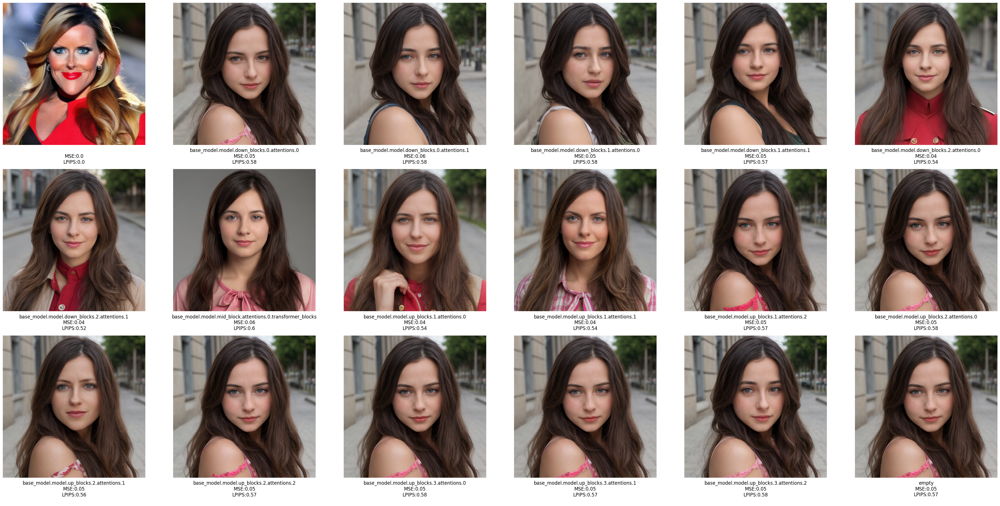

In [15]:
fig, axes = plt.subplots(3, len(metrics)//3, figsize=(6 * 6, 18))

for ax, (k, v) in zip(axes.flatten(), metrics.items()):
    m, l, img, weights = v
    ax.imshow(img)
    ax.text(0.5, -0.1, f"{k}\nMSE:{round(m.item(),2)}\nLPIPS:{round(l.item(),2)}\n",fontsize=12, ha="center", va="center", transform=ax.transAxes)
    ax.axis("off")  # Hide axes

plt.tight_layout()
plt.show()

### 3.2 Editing whole block

In [16]:
metrics = {}
lpips = LPIPS(net_type='vgg', normalize=True)
key_groups = set([".".join(i.split(".")[:4]) for i in list(base_weights.keys())])
key_groups = sorted(list(key_groups))
key_groups = [""] + key_groups + ["empty"]

for g in key_groups:
    new_weights = deepcopy(base_weights)
    for key in base_weights.keys():
        if g not in key:        
            new_weights[key] = torch.zeros_like(base_weights[key])
            
    flattened_weights = torch.cat([w.flatten() for w in new_weights.values()])
    pipe1 = DiffusionPipeline.from_pretrained("stablediffusionapi/realistic-vision-v51", 
                                        torch_dtype=torch.float16,safety_checker = None,
                                        requires_safety_checker = False).to(device)

    pipe1.unet = PeftModel.from_pretrained(pipe1.unet, f"{model_path}/unet", adapter_name="identity1")
    # adapters_weights1 = load_peft_weights(f"{model_path}/unet", device="cuda:0")
    pipe1.unet.load_state_dict(new_weights, strict = False)
    pipe1.to(device)
    image1 = pipe1(prompt, num_inference_steps=ddim_steps, guidance_scale=guidance_scale,  negative_prompt=negative_prompt, latents = latents ).images[0]
    i1 = transform(image1)
    mse = torch.mean((i0 - i1) ** 2)
    img1 = i1.unsqueeze(0)
    l = lpips(img0, img1)
    metrics[g] = (mse, l, image1, flattened_weights)

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

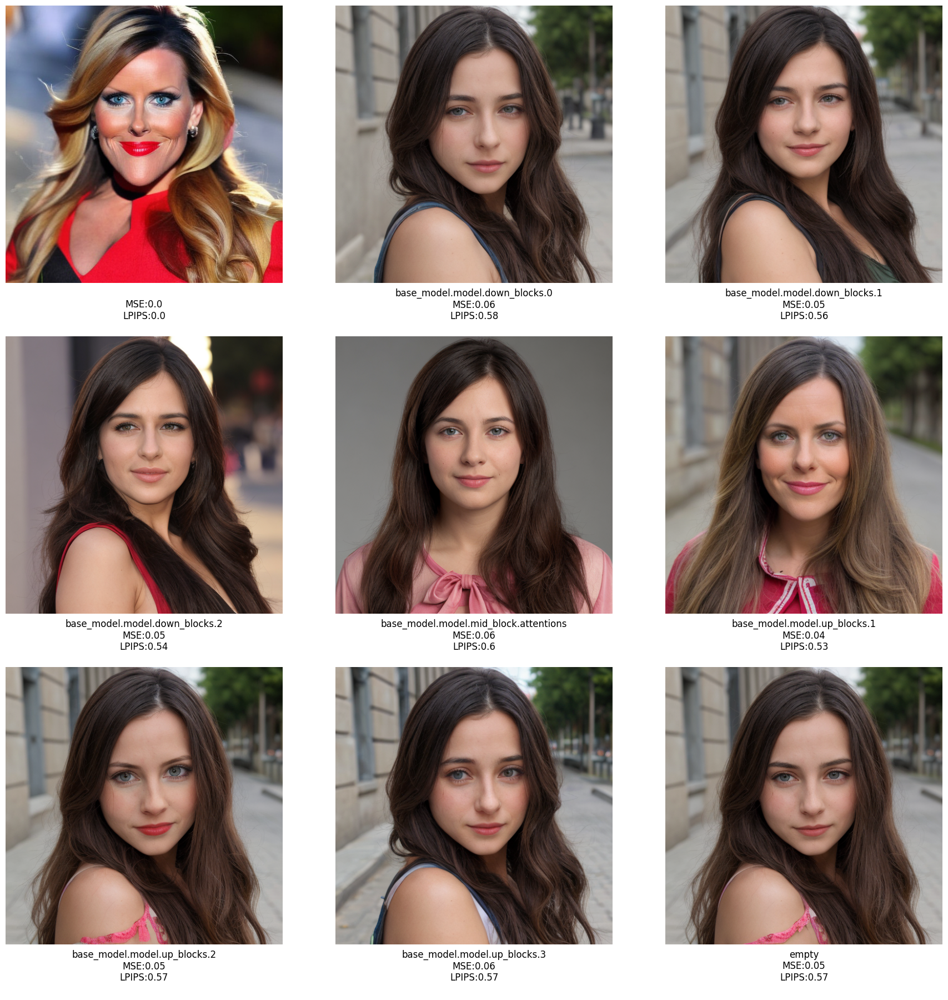

In [17]:
fig, axes = plt.subplots(3, len(metrics)//3, figsize=(3 * 6, 3*6))

for ax, (k, v) in zip(axes.flatten(), metrics.items()):
    m, l, img, weights = v
    ax.imshow(img)
    ax.text(0.5, -0.1, f"{k}\nMSE:{round(m.item(),2)}\nLPIPS:{round(l.item(),2)}\n",fontsize=12, ha="center", va="center", transform=ax.transAxes)
    ax.axis("off")  # Hide axes

plt.tight_layout()
plt.show()

### 3.3 Editing multiple blocks

In [18]:
metrics = {}
lpips = LPIPS(net_type='vgg', normalize=True)
key_groups = set([".".join(i.split(".")[:3]) for i in list(base_weights.keys())])
key_groups = sorted(list(key_groups))
key_groups = [""] + key_groups + ["empty"]

for g in key_groups:
    new_weights = deepcopy(base_weights)
    for key in base_weights.keys():
        if g not in key:        
            new_weights[key] = torch.zeros_like(base_weights[key])
            
    flattened_weights = torch.cat([w.flatten() for w in new_weights.values()])
    pipe1 = DiffusionPipeline.from_pretrained("stablediffusionapi/realistic-vision-v51", 
                                        torch_dtype=torch.float16,safety_checker = None,
                                        requires_safety_checker = False).to(device)

    pipe1.unet = PeftModel.from_pretrained(pipe1.unet, f"{model_path}/unet", adapter_name="identity1")
    # adapters_weights1 = load_peft_weights(f"{model_path}/unet", device="cuda:0")
    pipe1.unet.load_state_dict(new_weights, strict = False)
    pipe1.to(device)
    image1 = pipe1(prompt, num_inference_steps=ddim_steps, guidance_scale=guidance_scale,  negative_prompt=negative_prompt, latents = latents ).images[0]
    i1 = transform(image1)
    mse = torch.mean((i0 - i1) ** 2)
    img1 = i1.unsqueeze(0)
    l = lpips(img0, img1)
    metrics[g] = (mse, l, image1, flattened_weights)

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

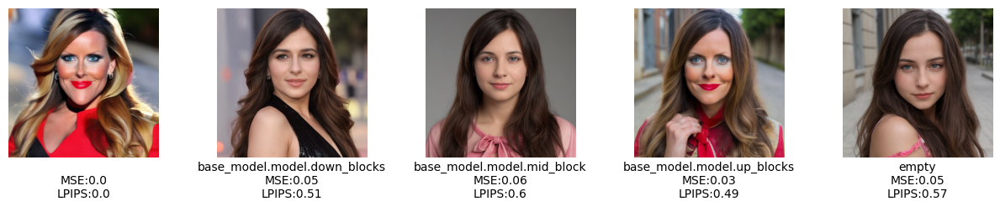

In [19]:
fig, axes = plt.subplots(1, len(metrics), figsize=(6*2, 6*5))

for ax, (k, v) in zip(axes.flatten(), metrics.items()):
    m, l, img, weights = v
    ax.imshow(img)
    ax.text(0.5, -0.2, f"{k}\nMSE:{round(m.item(),2)}\nLPIPS:{round(l.item(),2)}\n",fontsize=10, ha="center", va="center", transform=ax.transAxes)
    ax.axis("off")  # Hide axes

plt.tight_layout()
plt.show()